In [16]:
import librosa
import matplotlib.pyplot as plt
from IPython.display import Audio
import pandas as pd
import numpy as np 
import os
import soundfile as sf
import os


In [17]:
# data_set[data_set.chroma_stft.duplicated()]

In [18]:
data_set = pd.read_csv('Data/DATASET-balanced.csv')

data_set.shape

(11778, 27)

<Axes: >

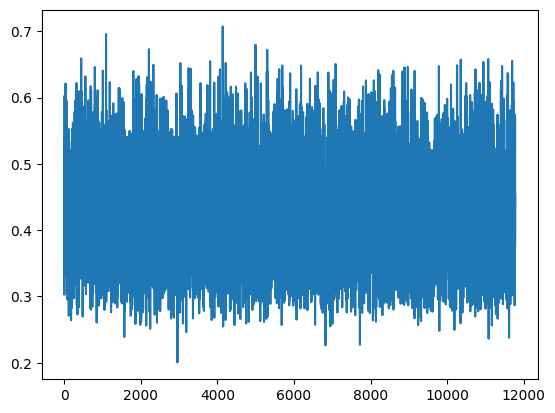

In [19]:
data_set.chroma_stft.plot()

In [20]:
12

12

In [21]:
data_set.shape

(11778, 27)

In [22]:
5889/600

9.815

In [23]:

data_set.LABEL.value_counts()

LABEL
FAKE    5889
REAL    5889
Name: count, dtype: int64

In [24]:
# 2. Load the audio as a waveform `y`
#    Store the sampling rate as `sr`

In [25]:
y, sr = librosa.load('Data/AUDIO/REAL/biden-original.wav')

In [26]:
sr

22050

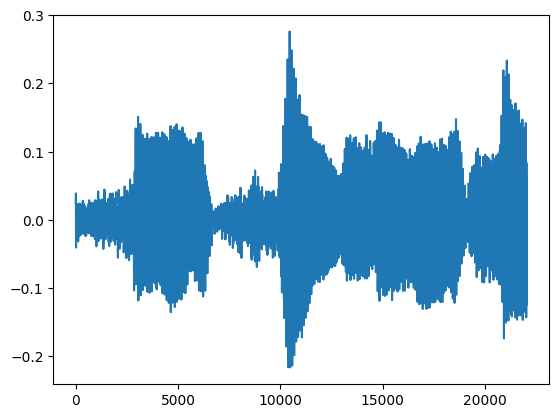

In [27]:
plt.plot(y[0:22050])

In [28]:
## chatGPT code:
# Calculate the STFT

stft = librosa.stft(y[0:sr])

# Map STFT powers to Mel scale using triangular filters
n_mels = 20
mel = librosa.filters.mel(sr=sr,n_fft=2048, n_mels=n_mels)

mel_spec = librosa.feature.melspectrogram(S=np.abs(stft)**2, sr=sr, n_mels=n_mels)
log_mel_spec = librosa.power_to_db(mel_spec, ref=np.max)

# Apply Discrete Cosine Transform (DCT) to obtain MFCCs
n_mfcc = 20
mfcc = librosa.feature.mfcc(S=log_mel_spec, n_mfcc=n_mfcc)

# Display the first 20 MFCCs
# print(mfcc[:20])
test2 = pd.DataFrame(mfcc.T)
test3 = pd.DataFrame(np.mean(mfcc, axis=1).T)

In [29]:
test2

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
0,-164.132278,40.675240,-29.422876,-5.979425,-8.383610,1.217147,-0.239385,-1.537195,-1.636052,0.076695,2.009064,4.194575,5.066152,1.774474,0.921843,0.193866,-1.939598,-1.257828,-0.499643,-0.022871
1,-153.395050,48.420784,-25.927145,0.339414,-6.068354,2.021313,0.586658,2.093378,1.127887,0.718691,1.605764,3.051692,4.531709,-0.971587,0.724671,-1.028233,-4.078760,-3.287440,-1.266237,0.895287
2,-148.735992,55.732666,-20.661404,6.411885,-2.619468,2.492546,1.709521,4.924537,2.192619,2.177705,2.226181,3.056753,3.118307,-2.456885,0.634727,-1.580237,-5.642492,-4.876517,-0.847486,1.320179
3,-146.074707,59.412170,-19.302710,8.176498,-1.077882,3.709603,1.723753,4.444746,1.156998,2.719042,0.572734,1.174081,1.432791,-2.635068,0.210006,-1.431076,-5.099242,-4.918761,0.006739,1.607317
4,-142.404221,60.561829,-14.997927,10.745572,-0.406976,3.009046,0.440567,3.183436,0.195287,0.453637,-0.307366,-0.502201,0.374742,-2.584643,-0.156862,-0.843559,-2.787753,-4.155972,1.351952,1.308969
5,-130.681839,67.342056,-9.801758,10.832251,-4.680653,-0.802980,-0.374418,2.038884,1.082717,-0.377578,-1.523171,-2.269948,-0.443181,-2.845280,1.656663,0.640180,-0.130044,-1.442417,2.338315,2.662796
6,-123.091248,74.367874,-6.351065,5.861616,-10.987541,-6.918090,2.736553,0.225743,2.643519,-1.604704,-2.975287,-0.714903,-1.028187,-6.794009,1.423951,-0.894723,0.580019,1.162804,1.398748,3.419338
7,-126.597336,76.571152,-7.013704,-2.452656,-11.209270,-11.241852,4.172123,-1.841580,3.681234,-1.827409,-2.609515,0.914926,-2.625682,-9.494091,0.541497,0.139456,1.128630,2.182942,0.159402,0.609550
8,-128.292496,76.314423,-11.641183,-7.715675,-11.076166,-12.158027,3.560553,0.988494,3.655045,-0.490283,-0.293353,-0.469720,-2.894402,-8.269266,0.830498,3.145187,0.345110,1.591574,-0.406693,-2.357098
9,-125.982117,71.004929,-19.949253,-10.465694,-13.231293,-11.620196,8.767355,0.891267,4.145174,2.819964,2.365196,-0.906579,-0.920247,-6.778563,1.840229,3.925801,-1.186188,0.086657,-1.375852,-1.177078


In [30]:
# 3. Run the default beat tracker


In [31]:
tempo, beat_frames = librosa.beat.beat_track(y=y, sr=sr)

In [32]:
Audio(y,rate=sr)

In [33]:
# Separate harmonics and percussives into two waveforms
y_harmonic, y_percussive = librosa.effects.hpss(y[0:sr])

In [34]:
# Compute chroma features from the harmonic signal
chromagram = librosa.feature.chroma_cqt(y=y_harmonic,
                                        sr=sr)

/opt/conda/lib/python3.10/site-packages/librosa/core/spectrum.py:257: UserWarning: n_fft=1024 is too large for input signal of length=690
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/librosa/core/spectrum.py:257: UserWarning: n_fft=1024 is too large for input signal of length=345
  warnings.warn(


In [35]:
#number of seconds in the sound clip

In [36]:
iter_ = int(y.shape[0]/sr)
iter_

600

In [37]:
for i in range(iter_):
    print(i*sr,(sr*i+sr))

0 22050
22050 44100
44100 66150
66150 88200
88200 110250
110250 132300
132300 154350
154350 176400
176400 198450
198450 220500
220500 242550
242550 264600
264600 286650
286650 308700
308700 330750
330750 352800
352800 374850
374850 396900
396900 418950
418950 441000
441000 463050
463050 485100
485100 507150
507150 529200
529200 551250
551250 573300
573300 595350
595350 617400
617400 639450
639450 661500
661500 683550
683550 705600
705600 727650
727650 749700
749700 771750
771750 793800
793800 815850
815850 837900
837900 859950
859950 882000
882000 904050
904050 926100
926100 948150
948150 970200
970200 992250
992250 1014300
1014300 1036350
1036350 1058400
1058400 1080450
1080450 1102500
1102500 1124550
1124550 1146600
1146600 1168650
1168650 1190700
1190700 1212750
1212750 1234800
1234800 1256850
1256850 1278900
1278900 1300950
1300950 1323000
1323000 1345050
1345050 1367100
1367100 1389150
1389150 1411200
1411200 1433250
1433250 1455300
1455300 1477350
1477350 1499400
1499400 1521450


In [38]:
data_set.columns

Index(['chroma_stft', 'rms', 'spectral_centroid', 'spectral_bandwidth',
       'rolloff', 'zero_crossing_rate', 'mfcc1', 'mfcc2', 'mfcc3', 'mfcc4',
       'mfcc5', 'mfcc6', 'mfcc7', 'mfcc8', 'mfcc9', 'mfcc10', 'mfcc11',
       'mfcc12', 'mfcc13', 'mfcc14', 'mfcc15', 'mfcc16', 'mfcc17', 'mfcc18',
       'mfcc19', 'mfcc20', 'LABEL'],
      dtype='object')

In [39]:
#get all features out of giver file 
def get_features(file_path, file_name):
    y, sr = librosa.load(file_path)
    iter_ = int(y.shape[0]/sr)
    features = []
    for i in range(iter_):
        y_seg = y[i*sr:(sr*i+sr)]
        chroma_stft = np.mean(librosa.feature.chroma_stft(y=y_seg, sr=sr))
        rms = np.mean(librosa.feature.rms(y=y_seg))
        spec_cent = np.mean(librosa.feature.spectral_centroid(y=y_seg, sr=sr))
        spec_bw = np.mean(librosa.feature.spectral_bandwidth(y=y_seg, sr=sr))
        rolloff = np.mean(librosa.feature.spectral_rolloff(y=y_seg, sr=sr))
        zcr = np.mean(librosa.feature.zero_crossing_rate(y_seg))
        mfcc = np.mean(librosa.feature.mfcc(y=y_seg, sr=sr, n_mfcc=20),axis=1)
        features.append([chroma_stft,rms,spec_cent,spec_bw,rolloff,zcr,*mfcc]) # starred expressions for mfcc to get 20 columns instead of 20 row
        # b = np.concatenate((b,a),axis=1) # ajout filename apres?
    return features
    


In [42]:
audio_dir='Data/AUDIO'
label = 'REAL'
files = os.listdir(os.path.join(audio_dir,label))
for file in files:
    print(os.path.join(audio_dir,label,file))
    

Data/AUDIO/REAL/linus-original.wav
Data/AUDIO/REAL/ryan-original.wav
Data/AUDIO/REAL/taylor-original.wav
Data/AUDIO/REAL/margot-original.wav
Data/AUDIO/REAL/musk-original.wav
Data/AUDIO/REAL/obama-original.wav
Data/AUDIO/REAL/trump-original.wav
Data/AUDIO/REAL/biden-original.wav


In [43]:
data_set.columns

Index(['chroma_stft', 'rms', 'spectral_centroid', 'spectral_bandwidth',
       'rolloff', 'zero_crossing_rate', 'mfcc1', 'mfcc2', 'mfcc3', 'mfcc4',
       'mfcc5', 'mfcc6', 'mfcc7', 'mfcc8', 'mfcc9', 'mfcc10', 'mfcc11',
       'mfcc12', 'mfcc13', 'mfcc14', 'mfcc15', 'mfcc16', 'mfcc17', 'mfcc18',
       'mfcc19', 'mfcc20', 'LABEL'],
      dtype='object')

In [53]:
#make dataframe with all the features
def make_features_df(audio_dir):
    labels = ['REAL','FAKE']  # add 'FAKE' later # audio are in separate folders: FAKE and REAL
    feature_list = []
    for label in labels:
        files = os.listdir(os.path.join(audio_dir, label))
        for file in files:
            file_features=get_features(os.path.join(audio_dir,label,file),file)
            for segment_features in file_features:
                    feature_list.append(segment_features + [label])

    features_df = pd.DataFrame(features_list,columns = data_set.columns)
    return features_df

                         
        
    

In [54]:
complete_df = make_features_df(audio_dir)

NameError: name 'features_list' is not defined

In [46]:
# new_df = make_features_df(audio_dir)

In [47]:
# new_df_R.shape

In [48]:
# complete_df = pd.concat([new_df,new_df2])

In [49]:
# complete_df

In [50]:
# complete_df.to_csv('data/New_features1.csv',index = False)

In [ ]:
# reload csv:
complete_df= pd.read_csv('data/New_features.csv')

data_set = pd.read_csv('Data/DATASET-balanced.csv')

complete_df.shape


In [ ]:
complete_df

In [ ]:
real_df = complete_df[complete_df['LABEL'] == 'REAL'][complete_df.columns[1:]]
fake_df = complete_df[complete_df['LABEL'] == 'FAKE'][complete_df.columns[1:]]


In [ ]:
real_df_o = data_set[data_set['LABEL'] == 'REAL'][data_set.columns]
real_df_o  

In [ ]:
compare_real_df = round(real_df.describe().T[['mean','50%','std']],2)
compare_real_df.rename(columns= {'mean':'v_1_mean','50%':'v_1_50%','std':'v_1_std'},inplace=True)
compare_real_df[['v_o_mean','v_o_50%','v_o_std']] = round(real_df_o.describe().T[['mean','50%','std']],2)
compare_real_df

# compare_real_df.rename( {'mean':'v_o_mean','50%':'v_o_50%','std':'v_o_std'})


In [ ]:
# round(real_df.describe().T[['mean','50%','std']],2)
round(fake_df.describe().T[['mean','50%','std']],2)


###  Estimators

#### XGBOOST

XGboost
number of estimators = nestimators

In [ ]:
!pip install xgboost



In [ ]:
from xgboost import XGBClassifier
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV, RandomizedSearchCV
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score, f1_score, recall_score, precision_score, auc
from sklearn.ensemble import RandomForestClassifier
# from sklearn.sklearn.model_selection import 


In [ ]:
df_train, df_test = train_test_split(complete_df, test_size=0.3,stratify=complete_df['LABEL'])

In [ ]:
df_test['LABEL'].value_counts()

In [ ]:
count = df_train['LABEL'].value_counts()
real_count = count.iloc[1]
real_count

In [ ]:
fake_under_sampled = df_train[df_train['LABEL']=='FAKE'].sample(real_count)
balanced_df = pd.concat([fake_under_sampled, df_train[df_train['LABEL']=='REAL']], axis=0)

balanced_df['LABEL'].value_counts()

In [ ]:
balanced_df

In [ ]:
X_train

In [ ]:
X_train = balanced_df[balanced_df.columns[0:-1]]
X_test = df_test[balanced_df.columns[0:-1]]

y_label = balanced_df['LABEL']
y_label_test = df_test['LABEL']


In [ ]:
le = LabelEncoder()
le.fit(y_label)
# le.classes_

y_train = le.transform(y_label)
y_test = le.transform(y_label_test)

# >>> le.inverse_transform([0, 0, 1, 2])


In [ ]:
le.classes_


In [ ]:
y_test.shape

In [ ]:
# Instantiate model
model_xgb = XGBClassifier(max_depth=10, 
                         n_estimators=300, 
                         learning_rate=0.1)

In [ ]:
score_accuracy = cross_val_score(model_xgb,X_train,y_train,cv=10,scoring='accuracy')

In [ ]:
score_accuracy.mean()

In [ ]:
model_xgb.fit(X_train,y_train)
y_pred = model_xgb.predict(X_test)
y_pred

In [ ]:

accuracy = accuracy_score(y_test,y_pred)
accuracy

In [ ]:
f1 = f1_score(y_test,y_pred)
f1

In [ ]:
recall = recall_score(y_test,y_pred)
recall

In [ ]:
precision = precision_score(y_test,y_pred)
precision

In [ ]:
#grid searching best params
param_grid =  {
    'max_depth': range(3,15),
    'learning_rate': [0.001, 0.01, 0.1, 0.2, 0.3],
    'n_estimators' : [200,250,300,350,400,450,500]
}

search_XGB = GridSearchCV(
    XGBClassifier(),
    param_grid=param_grid,
    cv=5,
    n_jobs=-1,
    verbose=1,
    scoring='precision'
)

search_XGB.fit(X_train, y_train);

svm_XGB_best = search_XGB.best_estimator_

In [ ]:
svm_XGB_best

In [ ]:
score_grid_accuracy = cross_val_score(svm_XGB_best,X_train,y_train,cv=10,scoring='accuracy')
score_grid_accuracy.mean()

In [ ]:
score_grid_precision = cross_val_score(svm_XGB_best,X_train,y_train,cv=10,scoring='precision')
score_grid_precision.mean()

In [ ]:
score_grid_recall = cross_val_score(svm_XGB_best,X_train,y_train,cv=10,scoring='recall')
score_grid_recall.mean()

In [ ]:
svm_XGB_best.fit(X_train,y_train)
y_pred_best = svm_XGB_best.predict(X_test)

y_pred_best

In [ ]:
accuracy2 = accuracy_score(y_test,y_pred_best)
accuracy2

In [ ]:
recall_score(y_test,y_pred_best)

In [ ]:
f12 = f1_score(y_test,y_pred_best)
f12

In [ ]:
precision2 = precision_score(y_test,y_pred_best)
precision2

In [ ]:
model_xgb = XGBClassifier(max_depth=10, 
                         n_estimators=300, 
                         learning_rate=0.1)

#### Random forest

In [ ]:
# randomf = R`

### 3 - Testing additional voices

In [ ]:
audio_dir_test='data/'
files = os.listdir(audio_dir_test)
files

In [ ]:
new_test_taylor_r = pd.read_csv('data/extracted_segment_10_extracted_segment_Taylor Swift Talks Record-Breaking Midnights Album, Music Video Cameos and Easter Eggs.csv')
# new_test0
new_test_bidenf = pd.read_csv('data/audio_features_biden_AI.csv')
new_test_bidenr = pd.read_csv('data/audio_features_biden.csv')
new_test_el = pd.read_csv('data/Elise.csv')
new_test_yr1 = pd.read_csv('data/Youssef.csv')

new_test_yr2 = pd.read_csv('data/Youssef_2.csv')
new_test_yf1 = pd.read_csv('data/Youssef_Eric Cartman.csv')
new_test_yf2 = pd.read_csv('data/Youssef_2_Female.csv')
new_test_yf3  = pd.read_csv('data/Youssef_2_Male Reggaeton.csv')

# new_test_MF_f  = pd.read_csv('data/Morgan Freeman_fake.csv')
new_test_MF_r  = pd.read_csv('data/Morgan Freeman_real.csv')

y_real = np.ones((1000,))
y_fake = np.zeros((1000,))


In [ ]:
new_test_taylor_r

In [ ]:
svm_XGB_best.classes_

In [ ]:
pred = svm_XGB_best.predict(new_test_taylor_r)
accuracy_score(y_real[:len(pred)],pred)


In [ ]:
pred = svm_XGB_best.predict(new_test_bidenf[new_test_bidenf.columns[0:-2]])
accuracy_score(y_fake[:len(pred)],pred)

In [ ]:
pred = svm_XGB_best.predict(new_test_bidenr[new_test_bidenf.columns[0:-2]])
accuracy_score(y_real[:len(pred)],pred)

In [ ]:
pred = svm_XGB_best.predict(new_test_el)
accuracy_score(y_real[:len(pred)],pred)

In [ ]:
pred = svm_XGB_best.predict(new_test_yr1)
accuracy_score(y_real[:len(pred)],pred)

In [ ]:
pred = svm_XGB_best.predict(new_test_yr2)
accuracy_score(y_real[:len(pred)],pred)

In [ ]:
pred = svm_XGB_best.predict(new_test_yf1)
accuracy_score(y_fake[:len(pred)],pred)

In [ ]:
pred = svm_XGB_best.predict(new_test_yf2)
accuracy_score(y_fake[:len(pred)],pred)

In [ ]:
pred = svm_XGB_best.predict(new_test_yf3)
accuracy_score(y_fake[:len(pred)],pred)

In [ ]:
pred = svm_XGB_best.predict(new_test_MF_f)
accuracy_score(y_fake[:len(pred)],pred)


In [ ]:
pred = svm_XGB_best.predict(new_test_MF_r)

accuracy_score(y_real[:len(pred)],pred)

In [ ]:
## new_test_MF_f.describe().T

In [ ]:
new_test_yf3.describe().T